# Uitleg methode 
Voor het oplossen van een magisch vierkant op papier heb ik gebruik gemaakt van Gauss-Jordan-Eliminatie. Hierbij heb je een aantal vergelijkingen met onbekende variabelen. Bijvoorbeeld: x + y = 10 en 2x + y = 15. Je weet hierbij niet wat x en y zijn. 

Om hier toch achter te komen zet je de vergelijkingen in een matrix. Hierbij zet je alleen de coëfficiënten van de variabelen x en y in de matrix. 


    [1 1 | 10 
    2 1 | 15]

Deze matrix moet je dan in Reduced-Row-Echolon vorm zetten. Hierbij moet je er dus voor zorgen dat er in elke rij een pivot-entry is, en je moet ervoor zorgen dat de getallen boven en onder de pivot-entry 0 zijn. Dit doe je dan door rijen van mekaar af te trekken of bij elkaar op te tellen. 

    R1: 1 1 | 10
    R2: 2 1 | 15

    R2 - (R1 x 2) = 0 -1 | -5

    [1  1 | 10 
    0 -1 | -5]

    R2 x -1 = 0 1 | 5

    [1 1 | 10 
    0 1 | 5]

    R1 - R2 = 1 0 | 5 

    [1 0 | 5 
    0 1 | 5]

Nu hebben we onze matrix in Reduced-Row-Echolon vorm. Hierdoor weten we nu dat x = 5 en dat y = 5 (iedere rij staat nu voor zijn eigen variabele, het getal achter de | is de waarde van deze variabele). 


Een magisch vierkant is eigenlijk een aantal vergelijkingen met bekende en onbekende variabelen. Door middel van Gauss-Jordan-Eliminatie kan je op deze manier dus ook een magisch vierkant oplossen. 

Verder materiaal over de methode:
https://www.youtube.com/watch?v=wY4TAheBsj4
https://www.youtube.com/watch?v=dlvNcr33M_Y
https://www.youtube.com/watch?v=0MF5iJ9NY0Q
https://www.youtube.com/watch?v=2j5Ic2V7wq4





# Magisch vierkant op papier

Het magisch vierkant: 
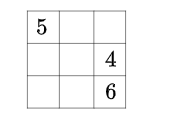


Mijn vergelijkingen:

    R1: 5 + B + C = 15       
    R2: D + E + 4 = 15       
    R3: G + H + 6 = 15       
    R4: 5 + D + G = 15       
    R5: B + E + H = 15       
    R6: C + 4 + 6 = 15      
    R7: E + 5 + 6 = 15

Verder uitgewerkte vergelijkingen: 

    R1: 1xB + 1xC + 0xD + 0xE + 0xG + 0xH = 10
    R2: 0xB + 0xC + 1xD + 1xE + 0xG + 0xH = 11
    R3: 0xB + 0xC + 0xD + 0xE + 1xG + 1xH = 9 
    R4: 0xB + 0xC + 1xD + 0xE + 1xG + 0xH = 10 
    R5: 1xB + 0xC + 0xD + 1xE + 0xG + 1xH = 15
    R6: 0xB + 1xC + 0xD + 0xE + 0xG + 0xH = 5
    R7: 0xB + 0xC + 0xD + 1xE + 0xG + 0xH = 4
    
    

Foto's van de uitwerkingen: 
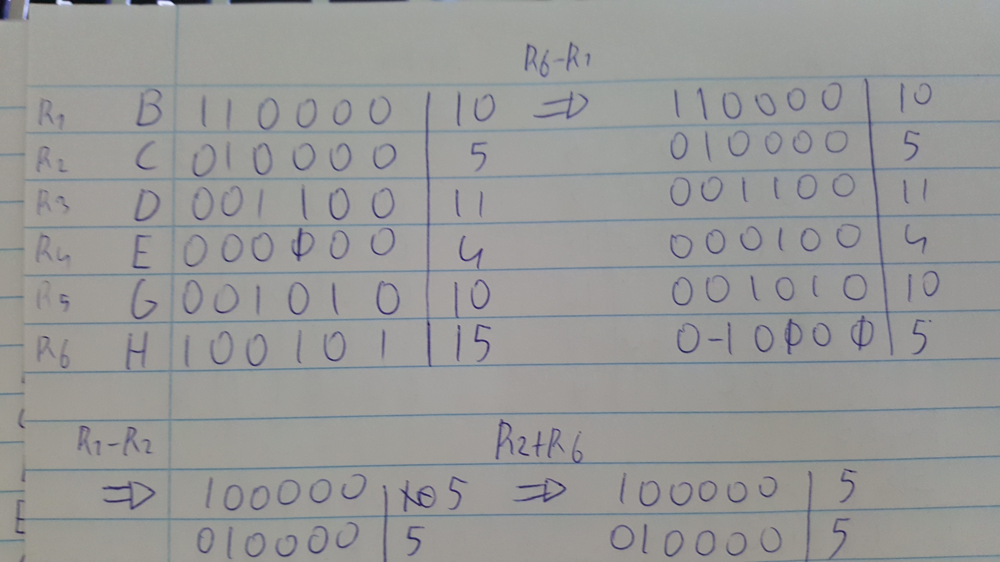
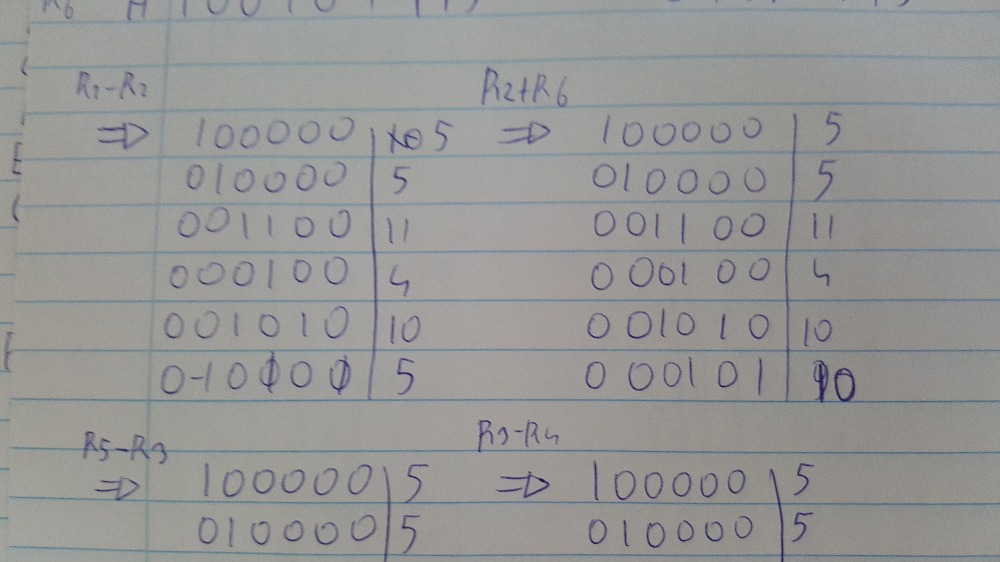
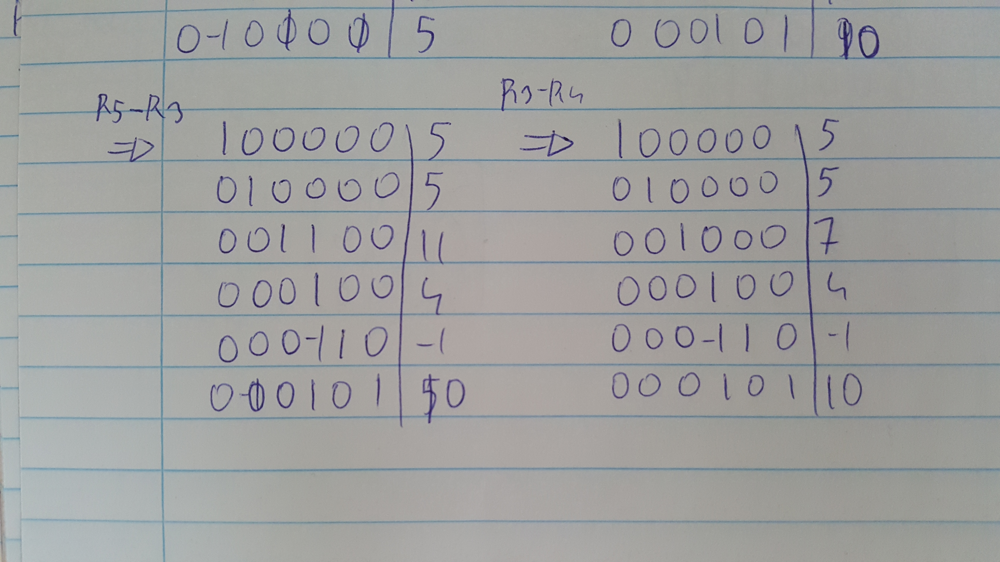
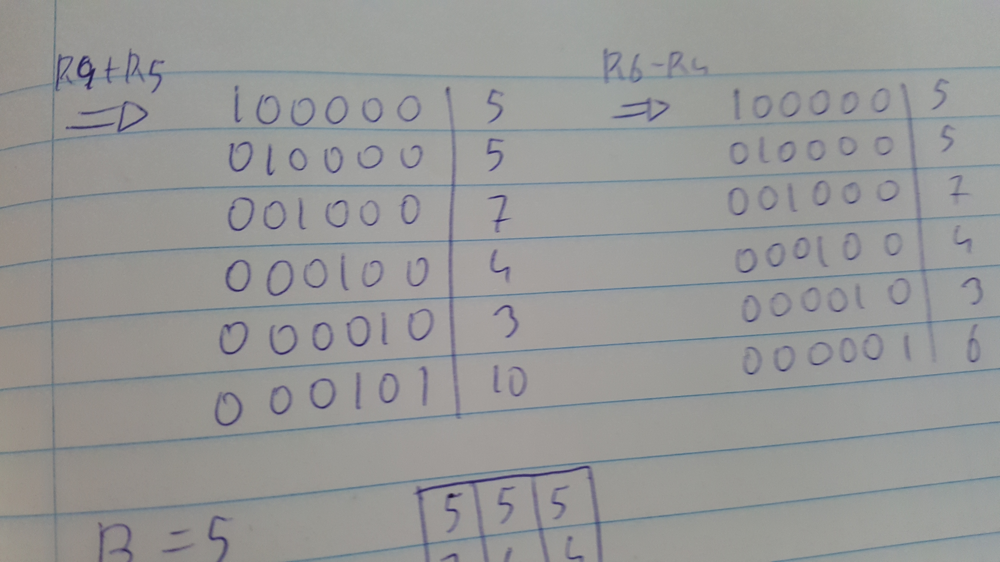

Antwoord: 
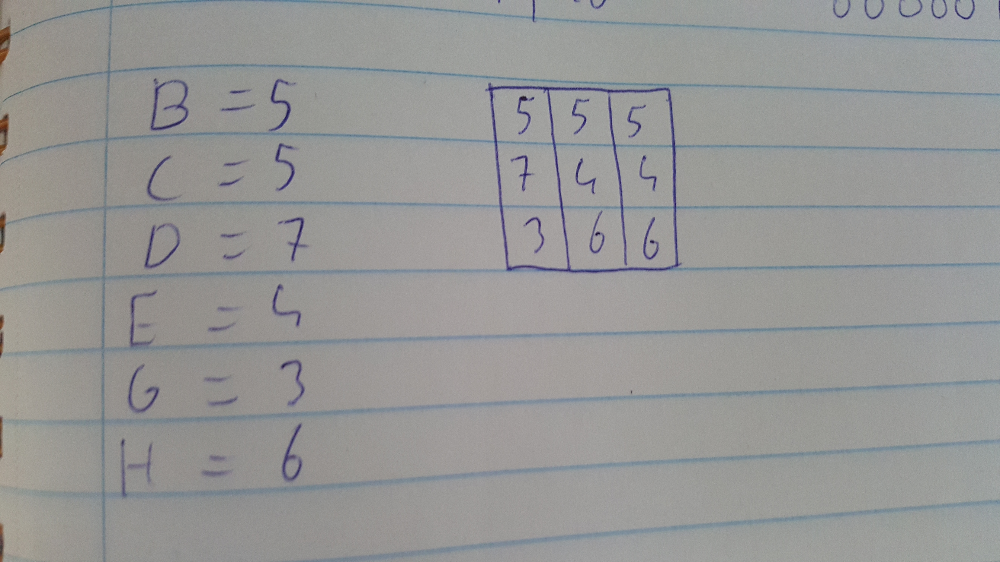

Eigenlijk heb ik geen oplossing kunnen vinden. Dit komt doordat het magisch vierkant dat op canvas staat, niet oplosbaar is. Als je al mijn gevonden getallen invult in het vierkant, dan zal je zien dat het tweede diagonaal (rechts onder naar links boven) niet op 15 uitkomt. 

Ik dacht dat je het tweede diagonaal niet hoefde mee te rekenen. Dit dacht ik dus verkeerd, vandaar dat het dus lijkt dat ik een oplossing heb gevonden, terwijl dat niet zo is. 

Om dit probleem op te kunnen lossen moet je volgens mij aan twee eisen voldoen:
1. de rank van de matrix maakt denk ik niet zo veel uit, wat wel uit maakt zijn de dimensies. De dimensies van een matrix moeten uiteindelijk gelijk zijn aan elkaar (dus bijv. een 3 bij 3 matrix, 4 bij 4 matrix etc. Dus geen 4 bij 5 matrix). 
2. De determinant mag geen 0 zijn. De determinant kan eigenlijk alleen worden gevonden bij een 3 bij 3 matrix en niet bij bijv. een 4 bij 5 matrix. De determinant is belangrijk voor het vinden van de inverse-matrix. Als de determinant 0 is, dan kan je eigenlijk geen inverse matrix vinden. 

# Implentatie in Python

Voor het oplossen van een magisch vierkant in Python zullen we geen gebruik maken van Reduced-Row-Echolon-Vorm. Echter gaan we gebruik maken van een inverse matrix. Hier volgt verder uitleg over. 



In [ ]:
import numpy
import math 


#global vars 
answers = {}
square = [[4, "B", "C"],
          ["D", 5, "F"],
          ["G", "H", 6]]

Ik heb een dictionary met 'antwoorden'. Deze zijn bedoeld zodat we weten wat de som in iedere optelling moet zijn (dit is voor elke rij 15, echter gaan we al ingevulde getallen hiervan aftrekken. Dus de som voor iedere optelling (horizontaal, verticaal etc.) kan dus net iets anders zijn hierdoor en dat is belangrijk voor de uiteindelijke berekening van de waardes van de onbekenden). 

Ook hebben we hier ons magisch vierkant. Dit is een twee dimensonale array. Dit om 1. aan te geven dat dit een magisch vierkant is en 2. om duidelijk onderscheid te maken tussen iedere rij in ons vierkant. 

In [ ]:
#matrix functions 
def horizontalMatrix(arr, matrix):
    pos = ["ABC", "DEF", "GHI"] 

    for i in range(len(arr)):
        row = [0, 0, 0, 0, 0, 0, 0, 0, 0]
        answer = 15
        for j in range(len(arr[i])):
            currVal = arr[i][j] 
            if isinstance(currVal, int):
                answer -= currVal
            elif currVal in pos[i]:
                index = (ord(currVal)-ord("A")) 
                row[(index)] = 1

        answers[pos[i]] = answer
        matrix.append(row)

        

def verticalMatrix(arr, matrix):
    pos = ["ADG", "BEH", "CFI"] 

    for i in range(len(arr)):
        row = [0, 0, 0, 0, 0, 0, 0, 0, 0]
        answer = 15
        for j in range(len(arr[i])):
            currVal = arr[j][i]
            if isinstance(currVal, int):
                answer -= currVal
            elif currVal in pos[i]:
                index = (ord(currVal)-ord("A"))
                row[(index)] = 1

        answers[pos[i]] = answer
        matrix.append(row)
        


def diagonalMatrix(arr, matrix):
    pos = ["AEI", "GEC"]
    answer = 15
    row = [0, 0, 0, 0, 0, 0, 0, 0, 0] 
    for i in range(len(arr)):
        currVal = arr[i][i]
        
        if isinstance(currVal, int): 
            answer -= currVal
        elif currVal in pos[0]:
            index = (ord(currVal)-ord("A"))
            row[(index)] = 1
            
    answers[pos[0]] = answer 
    matrix.append(row)
    answer = 15

    for i in range(len(arr)):
        currVal = arr[i][i]
        
        if isinstance(currVal, int): 
            answer -= currVal
        elif currVal in pos[1]:
            index = (ord(currVal)-ord("A"))
            row[(index)] = 1
                
    answers[pos[1]] = answer 
    matrix.append(row)


def makeMatrix(arr):
    matrix = []
    horizontalMatrix(arr, matrix)
    verticalMatrix(arr, matrix)
    diagonalMatrix(arr, matrix) 
 
    return matrix

Het twee-dimensionale array die we net zagen kunnen we nog niet gebruiken voor het uiteindelijke antwoord. We moeten het magisch vierkant omschrijven naar een aantal vergelijkingen. Deze vergelijkingen staan gelijk aan de vergelijkingen die ik liet zien in 'Magisch vierkant op papier' 

We hebben dus drie functies. horizontalMatrix, verticalMatrix en diagonalMatrix. Deze drie functies hebben als doel om vergelijkingen op te stellen. horizontalMatrix stelt drie vergelijkingen op voor de horizontale optellingen. verticalMatrix doet hetzelfde, alleen dan voor de verticale optellingen. DiagonalMatrix stelt vergelijkingen op voor de twee diagonale optellingen. 

Iedere functie krijgt een array (ons magisch vierkant) en de matrix (matrix van vergelijkingen) mee die we nog aan het opbouwen zijn. Iedere functie heeft ook een array genaamd 'pos'. 'pos' bepaalt voor welke rijen er momenteel een vergelijking wordt opgesteld. 

De functies gaan daarna door middel van een for-loop iedere rij langs. Voor iedere rij wordt een variabele antwoord (met waarde 15) en een array 'row' aangemaakt. 'row' bestaat in het begin uit 9 nullen. Het doel is om in de tweede (nested) for loop een aantal van die nullen te veranderen in enen, om zo uiteindelijk vergelijkingen te krijgen die het zelfde zijn als de vergelijkingen die ik liet zien in 'Magisch vierkant op papier'. 

In de nested for loop worden dus alle waarden in een rij bekeken. Is een van die waardes een getal? Dan wordt van variabele 'antwoord' dat getal ervan af getrokken (dus antwoord = antwoord - getal). Is de waarde een letter EN zit die letter in pos[index]? Dan wordt een index berekent (ASCII waarde van letter - ASCII waarde van "A") en deze index wordt dan gebruikt om in array 'row' een nul te veranderen in een 1. 

Zodra de functie klaar is met een rij wordt variabele 'antwoord' in dictionary 'antwoorden' geplaatst (de sleutel is een waarde uit 'pos'). De array 'row' wordt aan de gegeven matrix toegevoegd. 

Uiteindelijk komt hier, na het runnen van de 3 functies, een 8 bij 9 matrix uit. 

In [ ]:
def magicSquare(m):
    solution = {"A":m[0][0],
                "B":m[0][1],
                "C":m[0][2],
                "D":m[1][0],
                "E":m[1][1],
                "F":m[1][2],
                "G":m[2][0],
                "H":m[2][1],
                "I":m[2][2]
                }
    
    mNew = numpy.matrix(makeMatrix(m))
    ainv = numpy.linalg.pinv(mNew)
    ans = numpy.matrix(makeArr(answers))
    sol = numpy.squeeze(numpy.asarray(numpy.dot(ainv, ans)))
    if setSolution(solution, sol[1:]):
        return solution
    else:
        print(solution) 
        return "no solution could be found" 

Nu zijn we dan eindelijk belandt bij het oplossen van de matrix. In de functie 'magicSquare' starten we met een dictionary 'solution'. De naam zegt het eigelijk al: dit is een dictionary met de oplossing voor het magisch vierkant. In het begin zitten hier de start waardes van ons magisch vierkant in. De sleutel voor iedere waarde is een letter (om zo duidelijk de positie aan te geven). 

Daarna wordt een matrix 'mNew' aangemaakt. Hierbij maken we gebruik van de library 'numpy'. Numpy kan een array veranderen in een matrix. Dus eerst wordt functie 'makeMatrix' aangeroepen om een soort matrix te maken met alle vergelijken. Daarna wordt 'numpy.matrix' gebruikt om deze 2d-array om te zetten tot een echte matrix. 

Hierna wordt variabele 'ainv' aangemaakt. Ainv is de (pseudo)-inverse van de matrix mNew. Variabele 'ans' is de dictionary 'antwoorden' omgezet van een dictionary naar een matrix (over functie 'makeArr' volgt later verdere uitleg). 

variabele 'sol' is waar het uiteindelijke antwoord wordt berekend. Hierbij wordt het 'dot-product' van 'ainv' en 'ans' berekent. Hiervoor maken we weer gebruik van de numpy library. (numpy.asarray wordt gebruikt om de matrix weer terug te veranderen in een 2d array. numpy.squeeze zorgt ervoor dat de 2d-array wordt omgezet naar een 1d-array).

De reden dat we hier gebruik maken van een inverse-matrix is omdat 1. een computer hiervoor geoptimaliseerd is 2. row-echolon in code is veel lastiger. De vergelijking die we hier eigenlijk oplossen is: A vector(x) = vector(b). A is bekend (ons magisch vierkant ofwel onze uiteindelijke matrix) en b (het antwoord voor iedere rij) is bekend (of wordt in ieder geval per rij berekent en in zijn eigen matrix gezet). We willen weten wat x is. b/A = x. Echter kunnen we een matrix niet zo maar delen. Dus we moeten delen zonder echt te delen. Als we 2 willen delen door 2, zonder echt te delen, dan doen we 2 x 1/2 (1/2 is de inverse van 2). In ons geval dus: vector(b) x inverse(A) = vector(x) 

Op het laatst wordt functie 'setSolution' aangeroepen (hier volgt later uitleg over). De dictionary 'solution' wordt daarna uiteindelijk teruggegeven als antwoord voor het magisch vierkant. 

In [ ]:
#utility       
def makeArr(d):
    newArr = []
    for key in d:
        newArr.append([d[key]])

    return newArr 

makeArr zet een dictionary om naar een 1d-array. Er wordt een lege array aangemaakt. Daarna wordt de waarde van iedere 'sleutel' in de dictionary toegevoegd aan de lege array. 

In [3]:
def setSolution(d, arr):
    counter = 0 
    for key in d:
        if arr[counter] <= 0:
            counter += 1
            
        elif not isinstance(d[key], int):
            d[key] = math.ceil(arr[counter])
            if len(arr)-1 > counter: 
                counter += 1
    return True 

setSolution verandert de waardes in een dictionary om de oplossing er netter uit te laten zien. Deze waardes komen uit de array 'sol'. Als een waarde 0 is dan wordt deze niet als waarde van een positie gezet. Als er al een getal is ingevuld dan wordt deze niet aangepast in de dictionary. 

Een waarde in de dictionary wordt dus pas verandert als 1. de huidige waarde geen 0 of kleiner dan 0 is 2. als er nog geen getal is ingevuld in de huidige positie in de dictionary. 

# Belangrijke opmerkingen
De code is niet erg flexibel. Een magish vierkant kan alleen worden opgelost als de gegeven getallen in het eerste-diagonaal (links boven - rechts onder) staan. Anders kan het magisch vierkant niet worden opgelost. Het is mij een raadsel waarom dit zo is. Wat me wel opvalt, is dat er vaak een komma getal in de array 'sol' eindigt (maar dit gebeurt alleen wanneer de bekenden niet in het eerste diagonaal staan! Als de bekende in het eerste diagonaal staan dan is het enige komma getal een negatief getal en hier wordt rekening mee gehouden). Ik weet niet waar deze vandaan komt en of dit wellicht de boosdoener kan zijn. 

In [2]:
import numpy
import math 


#global vars 
answers = {}
square = [[2, "B", "C"],
          ["D", 5, "F"],
          ["G", "H", 8]]



#utility       
def makeArr(d):
    newArr = []
    for key in d:
        newArr.append([d[key]])

    return newArr 
        

#matrix functions 
def horizontalMatrix(arr, matrix):
    pos = ["ABC", "DEF", "GHI"] 

    for i in range(len(arr)):
        row = [0, 0, 0, 0, 0, 0, 0, 0, 0]
        answer = 15
        for j in range(len(arr[i])):
            currVal = arr[i][j] 
            if isinstance(currVal, int):
                answer -= currVal
            elif currVal in pos[i]:
                index = (ord(currVal)-ord("A"))
                row[(index)] = 1

        answers[pos[i]] = answer
        matrix.append(row)

        

def verticalMatrix(arr, matrix):
    pos = ["ADG", "BEH", "CFI"] 

    for i in range(len(arr)):
        row = [0, 0, 0, 0, 0, 0, 0, 0, 0]
        answer = 15
        for j in range(len(arr[i])):
            currVal = arr[j][i]
            if isinstance(currVal, int):
                answer -= currVal
            elif currVal in pos[i]:
                index = (ord(currVal)-ord("A"))
                row[(index)] = 1

        answers[pos[i]] = answer
        matrix.append(row)
        


def diagonalMatrix(arr, matrix):
    pos = ["AEI", "GEC"]
    answer = 15
    row = [0, 0, 0, 0, 0, 0, 0, 0, 0] 
    for i in range(len(arr)):
        currVal = arr[i][i]
        
        if isinstance(currVal, int): 
            answer -= currVal
        elif currVal in pos[0]:
            index = (ord(currVal)-ord("A"))
            row[(index)] = 1
            
    answers[pos[0]] = answer 
    matrix.append(row)
    answer = 15

    for i in range(len(arr)):
        currVal = arr[i][i]
        
        if isinstance(currVal, int): 
            answer -= currVal
        elif currVal in pos[1]:
            index = (ord(currVal)-ord("A"))
            row[(index)] = 1
                
    answers[pos[1]] = answer 
    matrix.append(row)
        
                       
def makeMatrix(arr):
    matrix = []
    horizontalMatrix(arr, matrix)
    verticalMatrix(arr, matrix)
    diagonalMatrix(arr, matrix) 
 
    return matrix


#magic square functions    
def setSolution(d, arr):
    counter = 0 
    for key in d:
        if arr[counter] <= 0:
            counter += 1
            
        elif not isinstance(d[key], int):
            d[key] = math.ceil(arr[counter])
            if len(arr)-1 > counter: 
                counter += 1
    return True 
                

def magicSquare(m):
    solution = {"A":m[0][0],
                "B":m[0][1],
                "C":m[0][2],
                "D":m[1][0],
                "E":m[1][1],
                "F":m[1][2],
                "G":m[2][0],
                "H":m[2][1],
                "I":m[2][2]
                }
    
    mNew = numpy.matrix(makeMatrix(m))
    ainv = numpy.linalg.pinv(mNew)
    ans = numpy.matrix(makeArr(answers)) 
    sol = numpy.squeeze(numpy.asarray(numpy.dot(ainv, ans)))
    setSolution(solution, sol)
    return solution
 
print("this is the solution: \n", magicSquare(square))

this is the solution: 
 {'A': 2, 'B': 8, 'C': 5, 'D': 8, 'E': 5, 'F': 2, 'G': 5, 'H': 2, 'I': 8}
